# Creating the model

### Installation

#### Clone and install the Tensorflow Object Detection API 

In [ ]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 56913, done.
remote: Counting objects: 100% (54/54), done.
remote: Compressing objects: 100% (51/51), done.
remote: Total 56913 (delta 11), reused 32 (delta 0), pack-reused 56859
Receiving objects: 100% (56913/56913), 572.42 MiB | 29.81 MiB/s, done.
Resolving deltas: 100% (39329/39329), done.


In [ ]:
%cd /content/models/research/
!protoc object_detection/protos/*.proto --python_out=.
# Install TensorFlow Object Detection API.
!cp object_detection/packages/tf2/setup.py .
!python -m pip install .

/content/models/research
Processing /content/models/research
     |████████████████████████████████| 9.6MB 4.7MB/s 
     |████████████████████████████████| 358kB 51.1MB/s 
     |████████████████████████████████| 1.1MB 49.9MB/s 
     |████████████████████████████████| 829kB 50.1MB/s 
     |████████████████████████████████| 2.3MB 48.8MB/s 
     |████████████████████████████████| 153kB 24.9MB/s 
     |████████████████████████████████| 61kB 6.2MB/s 
     |████████████████████████████████| 174kB 34.5MB/s 
     |████████████████████████████████| 706kB 42.5MB/s 
     |████████████████████████████████| 37.6MB 96kB/s 
     |████████████████████████████████| 51kB 5.3MB/s 
     |████████████████████████████████| 1.2MB 40.4MB/s 
     |████████████████████████████████| 102kB 440kB/s 
     |████████████████████████████████| 645kB 41.2MB/s 
  Created wheel for object-detection: filename=object_detection-0.1-cp37-none-any.whl size=1648391 sha256=e14579756199e3e16ba473be090df075581318f1040fc464be0125e7

Run model builder test

In [ ]:
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py

2021-05-06 18:25:38.685905: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Running tests under Python 3.7.10: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)
2021-05-06 18:25:42.358191: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-05-06 18:25:42.389811: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-05-06 18:25:42.477245: E tensorflow/stream_executor/cuda/cuda_driver.cc:328] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2021-05-06 18:25:42.477310: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (56a8f9ddde00): /proc/driver/nvidia/version does not exist
2021-05-06 18:25:42.477921: I tensorflow/compiler/jit/xla_gpu_device

### Getting the data

In [ ]:
!pip install -q kaggle
!pip install -q kaggle-cli

     |████████████████████████████████| 81kB 2.5MB/s 
     |████████████████████████████████| 4.2MB 4.2MB/s 
     |████████████████████████████████| 112kB 32.2MB/s 
     |████████████████████████████████| 51kB 4.5MB/s 
     |████████████████████████████████| 143kB 20.9MB/s 
  ERROR: Failed building wheel for lxml
    Running setup.py install for lxml ... error
ERROR: Command errored out with exit status 1: /usr/bin/python3 -u -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-x99p366o/lxml/setup.py'"'"'; __file__='"'"'/tmp/pip-install-x99p366o/lxml/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' install --record /tmp/pip-record-vy08a23z/install-record.txt --single-version-externally-managed --compile Check the logs for full command output.


In [ ]:
import os
os.environ['KAGGLE_USERNAME'] = 'seanmc4'
os.environ['KAGGLE_KEY'] = '211b552a57d1ca1018f46f0f6ef91f65'

In [ ]:
%%bash
rm /content/dataset/ -r
mkdir /content/dataset
cd /content/dataset
kaggle datasets download -d seanmc4/Swimmers --unzip

rm: cannot remove '/content/dataset/': No such file or directory
100%|##########| 14.5M/14.5M [00:00<00:00, 36.6MB/s]


##### Create a `labelmap.pbtxt` file, following the pattern:



```
item {
  name: "kangaroo"
  id: 1
}
```



##### Converting data to tf record
The Raccoon dataset contains two files train_labels.csv and test_labels.csv which need to be converted into TFRecord format so that it can be fed into Tensorflow’s object Detection API.

In [ ]:
%cd /content/

/content


In [ ]:
!wget https://raw.githubusercontent.com/hugozanini/object-detection/master/generate_tf_record.py

--2021-05-06 18:27:05--  https://raw.githubusercontent.com/hugozanini/object-detection/master/generate_tf_record.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5076 (5.0K) [text/plain]
Saving to: ‘generate_tf_record.py’

generate_tf_record. 100%[===================>]   4.96K  --.-KB/s    in 0s      

2021-05-06 18:27:05 (44.3 MB/s) - ‘generate_tf_record.py’ saved [5076/5076]



In [ ]:
!python generate_tf_record.py -l labelmap.txt -o dataset/train.record -i dataset/images -csv dataset/train_labels.csv
!python generate_tf_record.py -l labelmap.txt -o dataset/test.record -i dataset/images -csv dataset/test_labels.csv

2021-05-06 18:28:31.622668: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
INFO:Successfully created the TFRecords: dataset/train.record
2021-05-06 18:28:35.066701: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
INFO:Successfully created the TFRecords: dataset/test.record


### Configuring train

We are going to use the pretrained TF2 MobileNet V2 model as the feature extractor in the SSD MobileNet V2 Object Detection model. So the next logical step is to download and untar the pretrained TF2 MobileNet V2 model.

#### Downloading MobileNet weights

In [ ]:
%cd /content
!wget http://download.tensorflow.org/models/object_detection/classification/tf2/20200710/mobilenet_v2.tar.gz
!tar -xvf mobilenet_v2.tar.gz
!rm mobilenet_v2.tar.gz

/content
--2021-05-06 18:28:43--  http://download.tensorflow.org/models/object_detection/classification/tf2/20200710/mobilenet_v2.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 173.194.217.128, 2607:f8b0:400c:c13::80
Connecting to download.tensorflow.org (download.tensorflow.org)|173.194.217.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 8404070 (8.0M) [application/x-tar]
Saving to: ‘mobilenet_v2.tar.gz’

mobilenet_v2.tar.gz 100%[===================>]   8.01M  --.-KB/s    in 0.04s   

2021-05-06 18:28:43 (218 MB/s) - ‘mobilenet_v2.tar.gz’ saved [8404070/8404070]

mobilenet_v2/
mobilenet_v2/mobilenet_v2.ckpt-1.index
mobilenet_v2/checkpoint
mobilenet_v2/mobilenet_v2.ckpt-1.data-00001-of-00002
mobilenet_v2/mobilenet_v2.ckpt-1.data-00000-of-00002


In [ ]:
!wget https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_320x320_coco17_tpu-8.config
!mv ssd_mobilenet_v2_320x320_coco17_tpu-8.config mobilenet_v2.config

--2021-05-06 18:28:48--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_320x320_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4484 (4.4K) [text/plain]
Saving to: ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.config’

ssd_mobilenet_v2_32 100%[===================>]   4.38K  --.-KB/s    in 0s      

2021-05-06 18:28:48 (59.8 MB/s) - ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.config’ saved [4484/4484]



#### Defining training parameters

In [ ]:
num_classes = 4
batch_size = 16 #16
num_steps = 10000 #1500
num_eval_steps = 1000

train_record_path = '/content/dataset/train.record'
test_record_path = '/content/dataset/test.record'
model_dir = '/content/training/'
labelmap_path = '/content/labelmap.pbtxt'

pipeline_config_path = 'mobilenet_v2.config'
fine_tune_checkpoint = '/content/mobilenet_v2/mobilenet_v2.ckpt-1'

#### Editing config file

In [ ]:
import re

with open(pipeline_config_path) as f:
    config = f.read()

with open(pipeline_config_path, 'w') as f:

  # Set labelmap path
  config = re.sub('label_map_path: ".*?"', 
             'label_map_path: "{}"'.format(labelmap_path), config)
  
  # Set fine_tune_checkpoint path
  config = re.sub('fine_tune_checkpoint: ".*?"',
                  'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), config)
  
  # Set train tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 
                  'input_path: "{}"'.format(train_record_path), config)
  
  # Set test tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 
                  'input_path: "{}"'.format(test_record_path), config)
  
  # Set number of classes.
  config = re.sub('num_classes: [0-9]+',
                  'num_classes: {}'.format(num_classes), config)
  
  # Set batch size
  config = re.sub('batch_size: [0-9]+',
                  'batch_size: {}'.format(batch_size), config)
  
  # Set training steps
  config = re.sub('num_steps: [0-9]+',
                  'num_steps: {}'.format(num_steps), config)
  
  f.write(config)

### Training the Network

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_config_path} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2021-05-06 18:37:04.217595: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-05-06 18:37:07.341650: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-05-06 18:37:07.343062: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-05-06 18:37:07.355245: E tensorflow/stream_executor/cuda/cuda_driver.cc:328] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2021-05-06 18:37:07.355322: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (56a8f9ddde00): /proc/driver/nvidia/version does not exist
2021-05-06 18:37:07.356099: I tensorflow/compiler/jit/xla_gpu_device.cc:99] Not creating XLA devices, tf_xla_enable_xla_devices not set
W0506 18:37:07.356889 140708717160320 cross_device_ops.py:1321] There are no

### Validation

Here we're going yo run the code through a llop that waits for checkpoints to evaluate. Once the evaluation finishes, you're going to see the message:

`INFO:tensorflow:Waiting for new checkpoint at /content/training/`

Then you can stop the cell


In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_config_path} \
    --model_dir={model_dir} \
    --checkpoint_dir={model_dir}           ##This is passed to run ONLY EVALUATION

python3: can't open file '/content/models/research/object_detection/model_main_tf2.py': [Errno 2] No such file or directory


### Training and validation Metrics 

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/training/'

<IPython.core.display.Javascript object>

### Export the Inference Graph

The below code cell adds a line to the tf_utils.py file. This is a temporary fix to a exporting issue occuring when using the OD API with Tensorflow 2. This code will be removed as soon as the OD Team puts out a fix.

All credit goes to the Github users [Jacobsolawetz](https://github.com/Jacobsolawetz) and [ Tanner Gilbert](https://github.com/TannerGilbert), who provided this [temporary fix](https://github.com/tensorflow/models/issues/8841#issuecomment-657647648).

In [ ]:
with open('/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/utils/tf_utils.py') as f:
    tf_utils = f.read()

with open('/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/utils/tf_utils.py', 'w') as f:
  # Set labelmap path
  throw_statement = "raise TypeError('Expected Operation, Variable, or Tensor, got ' + str(x))"
  tf_utils = tf_utils.replace(throw_statement, "if not isinstance(x, str):" + throw_statement)
  f.write(tf_utils)

In [ ]:
output_directory = 'inference_graph'

!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {model_dir} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_config_path}

##### Downloading weights

In [ ]:
!zip -r /content/saved_model.zip /content/inference_graph/saved_model/

In [ ]:
from google.colab import files
files.download("/content/saved_model.zip")

###  Testing the trained model

Based on [Object Detection API Demo](https://github.com/tensorflow/models/blob/master/research/object_detection/colab_tutorials/object_detection_tutorial.ipynb) and [Inference from saved model tf2 colab](https://github.com/tensorflow/models/blob/master/research/object_detection/colab_tutorials/inference_from_saved_model_tf2_colab.ipynb).

In [ ]:
!wget https://raw.githubusercontent.com/hugozanini/object-detection/master/inferenceutils.py
from inferenceutils import *

##### Loading the model

In [ ]:
output_directory = 'inference_graph/'

In [ ]:
category_index = label_map_util.create_category_index_from_labelmap(labelmap_path, use_display_name=True)
tf.keras.backend.clear_session()
model = tf.saved_model.load(f'/content/{output_directory}/saved_model')

##### Selecting the images to test

In [ ]:
import pandas as pd
test = pd.read_csv('dataset/test_labels.csv')
images = list(test['filename'][0:20])

##### Doing inference

[1 3 2 3 4 3 3 1 3 3 3 3 1 1 3 1 1 4 4 3 1 3 1 1 3 3 3 4 3 3 1 3 1 4 3 2 1
 3 3 3 4 3 2 2 3 4 4 1 1 4 1 1 3 4 3 2 1 2 4 3 3 3 2 1 3 3 4 2 3 2 4 3 3 3
 3 1 3 3 1 3 1 3 3 3 2 3 3 1 3 3 3 3 3 4 3 1 4 3 3 1]
[[0.21682154 0.2926156  0.5892278  0.7229324 ]
 [0.13331214 0.         0.92375827 0.46109396]
 [0.20023274 0.2864062  0.58505094 0.7584065 ]
 [0.23312189 0.27646267 0.5700738  0.75399053]
 [0.20023274 0.2864062  0.58505094 0.7584065 ]
 [0.1326279  0.14105538 0.8296452  0.8711237 ]
 [0.05830848 0.0505017  0.75860894 0.6850046 ]
 [0.2750344  0.27361202 0.541898   0.83233273]
 [0.21714845 0.         0.897926   0.6234647 ]
 [0.34329128 0.         0.9566566  0.72129667]
 [0.15500915 0.24018654 0.6843591  0.78985083]
 [0.10492724 0.         1.         0.27047718]
 [0.34329128 0.         0.9566566  0.72129667]
 [0.42564645 0.297943   0.9670737  1.        ]
 [0.42564645 0.297943   0.9670737  1.        ]
 [0.39820376 0.08091688 0.9706631  0.9549657 ]
 [0.24317485 0.35878354 0.75144875 0.9557412

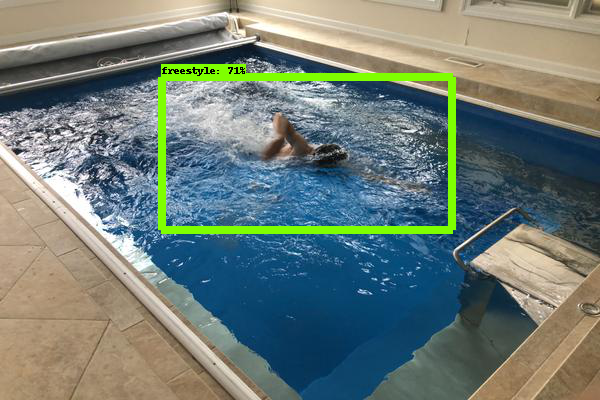

None


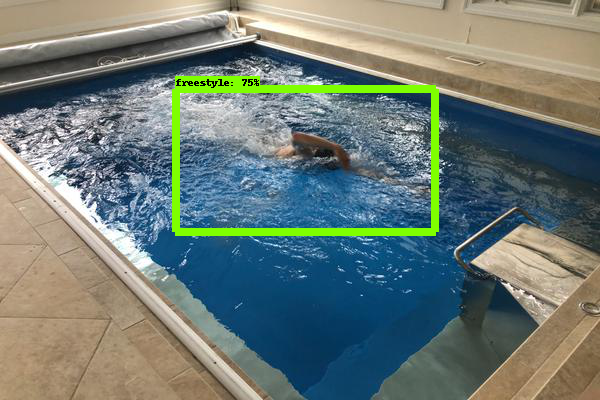

None


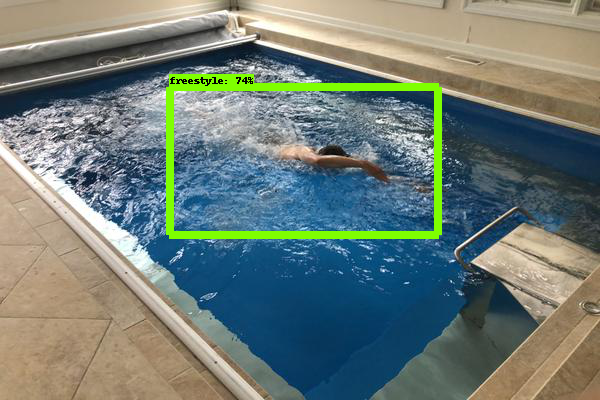

None


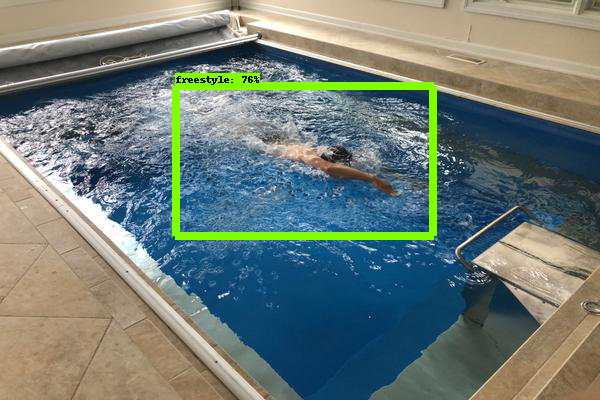

In [ ]:
images = ['IMG_6317.jpeg', 'IMG_6128.jpeg', 'IMG_6248.jpeg']

for image_name in images:
  
  image_np = load_image_into_numpy_array('dataset/images/' + image_name)
  output_dict = run_inference_for_single_image(model, image_np)
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)
  display(Image.fromarray(image_np))

### References

Blog post: https://gilberttanner.com/blog/tensorflow-object-detection-with-tensorflow-2-creating-a-custom-model

Notebook: https://github.com/TannerGilbert/Tensorflow-Object-Detection-API-Train-Model/blob/master/Tensorflow_2_Object_Detection_Train_model.ipynb

Blog post: https://medium.com/swlh/image-object-detection-tensorflow-2-object-detection-api-af7244d4c34e

Notebook: https://github.com/TannerGilbert/Tensorflow-Object-Detection-API-Train-Model/blob/master/Tensorflow_2_Object_Detection_Train_model.ipynb

Model Zoo: https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md

Models configs: https://github.com/tensorflow/models/tree/master/research/object_detection/configs/tf2

https://gist.github.com/woudsma/d01eeda8998c9ab972d05ec9e9843886

https://github.com/tensorflow/tfjs/tree/master/tfjs-converter